# Presets

In [38]:
import matplotlib.pyplot as plt
import seaborn           as sns
import pandas            as pd
import numpy             as np
import zero_point        as zp   # for Gaia parallax zero point correction (Lindegren et al. 2020)
import os
from IPython.display import display, HTML

In [39]:
# Load the matched_catalogue_full.csv
catalogue = pd.read_csv('matched_catalogue_full_2MASS_AIIWise.csv', dtype={'source_id': str, 'W1mag': str})

In [40]:
# Select the columns you want by name
columns_to_display = ['index', 'name', 'ra', 'dec', 'source_id', 'cross-match_2.5', "ra_error","dec_error","pm","pmra","pmra_error",
                      "pmdec","pmdec_error","phot_g_mean_mag","nu_eff_used_in_astrometry","pseudocolour","ecl_lat","astrometric_params_solved", 'cross-match_3', 
                      'gaia_ra', 'gaia_dec', 'Jmag', 'Hmag', 'Kmag', 'e_Jmag', 'e_Hmag', 'e_Kmag', 
                      'W1mag', 'W2mag', 'e_W1mag', 'e_W2mag']

# Ensure 'index' is a column by resetting the index if necessary
matched_catalogue_reset = catalogue.reset_index()

# Display the table
display(HTML("""
<style>
    .scrollable-table {
        max-height: 400px;
        overflow-y: scroll;
        display: block;
    }
</style>
""" + matched_catalogue_reset[columns_to_display].to_html(classes='table scrollable-table', index=False)))

index,name,ra,dec,source_id,cross-match_2.5,ra_error,dec_error,pm,pmra,pmra_error,pmdec,pmdec_error,phot_g_mean_mag,nu_eff_used_in_astrometry,pseudocolour,ecl_lat,astrometric_params_solved,cross-match_3,gaia_ra,gaia_dec,Jmag,Hmag,Kmag,e_Jmag,e_Hmag,e_Kmag,W1mag,W2mag,e_W1mag,e_W2mag
0,109 Psc b,26.232600,20.083150,95652018353917056,True,0.029087,0.025802,113.540527,-43.357210,0.042048,-104.936189,0.034248,6.109562,1.550539,NaN,8.621641,31.0,True,26.232401,20.082683,5.386,4.678,4.601,0.268,0.031,0.021,4.581,4.382,0.239,0.122
1,112 Psc b,30.038165,3.097014,2511794495013074048,True,0.091327,0.060094,345.047363,230.825607,0.138117,-256.470696,0.050905,5.736385,1.577238,NaN,-8.585389,31.0,True,30.039192,3.095874,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,112 Psc c,30.038165,3.097014,2511794495013074048,True,0.091327,0.060094,345.047363,230.825607,0.138117,-256.470696,0.050905,5.736385,1.577238,NaN,-8.585389,31.0,True,30.039192,3.095874,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,11 Com Ab,185.179167,17.792778,3946945413106333696,True,0.102660,0.103790,141.005447,-109.425802,0.143670,88.929919,0.106730,4.437253,1.474438,NaN,18.333928,31.0,True,185.178763,17.793264,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,11 UMi b,229.275000,71.823889,1696798367260229376,True,0.084304,0.077964,10.315161,4.073364,0.103914,9.476827,0.114159,4.556678,1.415327,NaN,74.958214,31.0,True,229.274597,71.823944,2.876,2.091,1.939,0.23,0.194,0.27,-0.29,0.143,--,--
5,14 And Ab,352.820833,39.236111,1920113512486282240,True,0.053545,0.043241,298.953949,286.897601,0.107559,-84.043076,0.060122,4.922183,1.474717,NaN,38.228976,31.0,True,352.824201,39.235825,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,14 Her b,242.595833,43.821667,1385293808145621504,True,0.022203,0.026762,324.931732,131.744750,0.027879,-297.025186,0.037211,6.395240,1.516567,NaN,62.878821,31.0,True,242.602127,43.816321,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,14 Her c,242.595833,43.821667,1385293808145621504,True,0.022203,0.026762,324.931732,131.744750,0.027879,-297.025186,0.037211,6.395240,1.516567,NaN,62.878821,31.0,True,242.602127,43.816321,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,16 Cyg Bb,295.462500,50.517500,2135550755683407232,True,0.013912,0.022196,211.082458,-134.481577,0.018312,-162.697596,0.026860,6.073419,1.560717,NaN,69.468021,31.0,True,295.465613,50.516802,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,18 Del Ab,314.608333,10.839167,1756741374681702784,True,0.057461,0.040246,60.687202,-49.920763,0.070463,-34.508749,0.043686,5.269335,1.495766,NaN,26.786773,31.0,True,314.607830,10.839133,4.032,3.440,3.366,0.236,0.186,0.204,3.37,2.931,0.373,0.416


# Zero-point corrections for parallaxes

In [41]:
data_kinematics = catalogue[['source_id', 'ra', 'ra_error', 'dec', 'dec_error', 'parallax', 
                           'parallax error', 'pm', 'pmra', 'pmra_error', 'pmdec', 'pmdec_error', 
                           'phot_g_mean_mag', 'nu_eff_used_in_astrometry', 'pseudocolour', 'ecl_lat',  
                           'astrometric_params_solved', 'RV', 'RV error']].copy()

In [42]:
np.unique(data_kinematics['astrometric_params_solved'], return_counts=True)

(array([ 3., 31., 95., nan]), array([  72, 5734,  486, 1088]))

In [43]:
data_kin_clean = data_kinematics.loc[((data_kinematics['pseudocolour'].isna()) | 
                                      (data_kinematics['pseudocolour'].between(1.24, 1.72, inclusive="both"))) &
                                     (data_kinematics['astrometric_params_solved']>3)]

In [44]:
data_kin_clean = data_kin_clean.reset_index(drop=True)

In [45]:
zp.zpt.load_tables()

In [46]:
zp_vals = zp.zpt.get_zpt(data_kin_clean['phot_g_mean_mag'].to_numpy(), 
                         data_kin_clean['nu_eff_used_in_astrometry'].to_numpy(), 
                         data_kin_clean['pseudocolour'].to_numpy(), 
                         data_kin_clean['ecl_lat'].to_numpy(), 
                         data_kin_clean['astrometric_params_solved'].to_numpy())

/home/juanjo/anaconda3/envs/ESA/lib/python3.8/site-packages/zero_point/zpt.py:215: UserWarning: The apparent magnitude of one or more of the sources is outside the expected range (6-21 mag). 
                Outside this range, there is no further interpolation, thus the values at 6 or 21 are returned.
  warnings.warn(


In [47]:
data_kin_clean['zero_point_correction'] = zp_vals

In [48]:
# Extra needed in this case:
data_kin_clean['parallax'] = pd.to_numeric(data_kin_clean['parallax'], errors='coerce')
data_kin_clean['zero_point_correction'] = pd.to_numeric(data_kin_clean['zero_point_correction'], errors='coerce')

data_kin_clean['parallax_zpt_corr'] = data_kin_clean['parallax'] + data_kin_clean['zero_point_correction']

In [49]:
# Ensure 'index' is a column by resetting the index if necessary
data_kin_clean_reset = data_kin_clean.reset_index()

display(HTML("""
<style>
    .scrollable-table {
        max-height: 400px;
        overflow-y: scroll;
        display: block;
    }
</style>
""" + data_kin_clean_reset.to_html(classes='table scrollable-table', index=False)))


index,source_id,ra,ra_error,dec,dec_error,parallax,parallax error,pm,pmra,pmra_error,pmdec,pmdec_error,phot_g_mean_mag,nu_eff_used_in_astrometry,pseudocolour,ecl_lat,astrometric_params_solved,RV,RV error,zero_point_correction,parallax_zpt_corr
0,95652018353917056,26.232600,0.029087,20.083150,0.025802,30.153470,0.0401986,113.540527,-43.357210,0.042048,-104.936189,0.034248,6.109562,1.550539,NaN,8.621641,31.0,-46.09077,0.12985718,-0.038562,30.114908
1,2511794495013074048,30.038165,0.091327,3.097014,0.060094,31.449211,0.05664607,345.047363,230.825607,0.138117,-256.470696,0.050905,5.736385,1.577238,NaN,-8.585389,31.0,-18.495573,0.13879412,-0.036507,31.412704
2,2511794495013074048,30.038165,0.091327,3.097014,0.060094,31.449211,0.05664607,345.047363,230.825607,0.138117,-256.470696,0.050905,5.736385,1.577238,NaN,-8.585389,31.0,-18.495573,0.13879412,-0.036507,31.412704
3,3946945413106333696,185.179167,0.102660,17.792778,0.103790,10.167680,0.13647683,141.005447,-109.425802,0.143670,88.929919,0.106730,4.437253,1.474438,NaN,18.333928,31.0,43.251984,0.13928862,-0.036289,10.131391
4,1696798367260229376,229.275000,0.084304,71.823889,0.077964,7.926043,0.087353095,10.315161,4.073364,0.103914,9.476827,0.114159,4.556678,1.415327,NaN,74.958214,31.0,-17.798492,0.12155637,-0.018566,7.907477
5,1920113512486282240,352.820833,0.053545,39.236111,0.043241,13.168146,0.072693095,298.953949,286.897601,0.107559,-84.043076,0.060122,4.922183,1.474717,NaN,38.228976,31.0,-59.80607,0.11967817,-0.031442,13.136704
6,1385293808145621504,242.595833,0.022203,43.821667,0.026762,55.865717,0.029119799,324.931732,131.744750,0.027879,-297.025186,0.037211,6.395240,1.516567,NaN,62.878821,31.0,-13.933623,0.12251234,-0.023369,55.842348
7,1385293808145621504,242.595833,0.022203,43.821667,0.026762,55.865717,0.029119799,324.931732,131.744750,0.027879,-297.025186,0.037211,6.395240,1.516567,NaN,62.878821,31.0,-13.933623,0.12251234,-0.023369,55.842348
8,2135550755683407232,295.462500,0.013912,50.517500,0.022196,47.330162,0.01712145,211.082458,-134.481577,0.018312,-162.697596,0.026860,6.073419,1.560717,NaN,69.468021,31.0,-27.865486,0.12334428,-0.022972,47.307190
9,1756741374681702784,314.608333,0.057461,10.839167,0.040246,13.302135,0.06518407,60.687202,-49.920763,0.070463,-34.508749,0.043686,5.269335,1.495766,NaN,26.786773,31.0,4.171299,0.11649046,-0.035279,13.266856


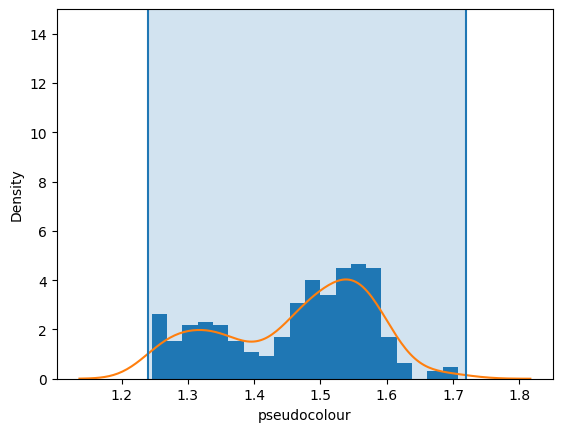

In [50]:
plt.hist(data_kin_clean['pseudocolour'], density=True, bins=20)
sns.kdeplot(data_kin_clean['pseudocolour'])
plt.axvline(x=1.24)
plt.axvline(x=1.72)
plt.fill_betweenx(y=[0, 15], x1=1.24, x2=1.72, alpha=0.2)
# plt.legend()
plt.ylim([0, 15])
plt.show()

In [ ]:
# for index, row in data_kin_clean.iterrows():
#     source_id = row['source_id']
#     zero_point_correction = row['zero_point_correction']
#     parallax_zpt_corr = row['parallax_zpt_corr']
    
#     matching_rows = catalogue[catalogue['source_id'] == source_id]
    
#     for idx in matching_rows.index:
#         catalogue.at[idx, 'zero_point_correction'] = zero_point_correction
#         catalogue.at[idx, 'parallax_zpt_corr'] = parallax_zpt_corr

# catalogue.to_csv('matched_catalogue_full_2MASS_AIIWise.csv', index=False)

In [52]:
catalogue = pd.read_csv('matched_catalogue_full_2MASS_AIIWise.csv', dtype={'source_id': str, 'W1mag': str})

columns_to_display = [
    'parallax', 'parallax error', 'RV', 'RV error', '[M/H]', '[M/H] lower', '[M/H] upper',
    'logg', 'logg lower', 'logg upper', 'T_eff', 'T_eff lower', 'T_eff upper',
    'Jmag', 'Hmag', 'Kmag', 'W1mag', 'W2mag',
    'e_Jmag', 'e_Hmag', 'e_Kmag', 'e_W1mag', 'e_W2mag',
    "ra_error", "dec_error", "pm", "pmra", "pmra_error", "pmdec", "pmdec_error", "phot_g_mean_mag",
    "pseudocolour",
    "nu_eff_used_in_astrometry",
    "ecl_lat", "astrometric_params_solved",
    'zero_point_correction', 'parallax_zpt_corr'
]

catalogue_reset = catalogue.reset_index()

display(HTML("""
<style>
    .scrollable-table {
        max-height: 600px;  /* Puedes ajustar la altura a tu gusto */
        overflow-y: scroll;
        display: block;
    }
</style>
""" + catalogue_reset[["index"] + columns_to_display].to_html(classes='table scrollable-table', index=False)))

index,parallax,parallax error,RV,RV error,[M/H],[M/H] lower,[M/H] upper,logg,logg lower,logg upper,T_eff,T_eff lower,T_eff upper,Jmag,Hmag,Kmag,W1mag,W2mag,e_Jmag,e_Hmag,e_Kmag,e_W1mag,e_W2mag,ra_error,dec_error,pm,pmra,pmra_error,pmdec,pmdec_error,phot_g_mean_mag,pseudocolour,nu_eff_used_in_astrometry,ecl_lat,astrometric_params_solved,zero_point_correction,parallax_zpt_corr
0,30.153469786700956,0.0401986,-46.09077,0.12985718,-0.0748,-0.1586000025272369,0.1607999950647354,4.0895,4.0776,4.0986,5515.974,5503.6543,5539.9272,5.386,4.678,4.601,4.581,4.382,0.268,0.031,0.021,0.239,0.122,0.029087,0.025802,113.540527,-43.357210,0.042048,-104.936189,0.034248,6.109562,NaN,1.550539,8.621641,31.0,-0.038562,30.114908
1,31.449211001564855,0.05664607,-18.495573,0.13879412,-0.1079,-0.1218999996781349,-0.096400000154972,4.0654,4.0634,4.0669,5877.3457,5875.2617,5879.437,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.091327,0.060094,345.047363,230.825607,0.138117,-256.470696,0.050905,5.736385,NaN,1.577238,-8.585389,31.0,-0.036507,31.412704
2,31.449211001564855,0.05664607,-18.495573,0.13879412,-0.1079,-0.1218999996781349,-0.096400000154972,4.0654,4.0634,4.0669,5877.3457,5875.2617,5879.437,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.091327,0.060094,345.047363,230.825607,0.138117,-256.470696,0.050905,5.736385,NaN,1.577238,-8.585389,31.0,-0.036507,31.412704
3,10.167679527196395,0.13647683,43.251984,0.13928862,-0.1642,-0.1867000013589859,-0.1447000056505203,2.4404,2.4011,2.5074,5059.802,5050.2554,5068.565,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.102660,0.103790,141.005447,-109.425802,0.143670,88.929919,0.106730,4.437253,NaN,1.474438,18.333928,31.0,-0.036289,10.131391
4,7.926043134899238,0.087353095,-17.798492,0.12155637,--,--,--,--,--,--,--,--,--,2.876,2.091,1.939,-0.29,0.143,0.23,0.194,0.27,--,--,0.084304,0.077964,10.315161,4.073364,0.103914,9.476827,0.114159,4.556678,NaN,1.415327,74.958214,31.0,-0.018566,7.907477
5,13.16814560392618,0.072693095,-59.80607,0.11967817,--,--,--,--,--,--,--,--,--,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.053545,0.043241,298.953949,286.897601,0.107559,-84.043076,0.060122,4.922183,NaN,1.474717,38.228976,31.0,-0.031442,13.136704
6,55.86571683862104,0.029119799,-13.933623,0.12251234,0.1783,0.1735000014305114,0.1833000034093856,4.4185,4.4178,4.4191,5177.202,5176.23,5178.254,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.022203,0.026762,324.931732,131.744750,0.027879,-297.025186,0.037211,6.395240,NaN,1.516567,62.878821,31.0,-0.023369,55.842348
7,55.86571683862104,0.029119799,-13.933623,0.12251234,0.1783,0.1735000014305114,0.1833000034093856,4.4185,4.4178,4.4191,5177.202,5176.23,5178.254,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.022203,0.026762,324.931732,131.744750,0.027879,-297.025186,0.037211,6.395240,NaN,1.516567,62.878821,31.0,-0.023369,55.842348
8,47.33016209584275,0.01712145,-27.865486,0.12334428,-0.0261,-0.0289999991655349,-0.013600000180304,4.2607,4.26,4.2631,5639.604,5638.418,5641.7407,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.013912,0.022196,211.082458,-134.481577,0.018312,-162.697596,0.026860,6.073419,NaN,1.560717,69.468021,31.0,-0.022972,47.307190
9,13.302135426379998,0.06518407,4.171299,0.11649046,--,--,--,--,--,--,--,--,--,4.032,3.440,3.366,3.37,2.931,0.236,0.186,0.204,0.373,0.416,0.057461,0.040246,60.687202,-49.920763,0.070463,-34.508749,0.043686,5.269335,NaN,1.495766,26.786773,31.0,-0.035279,13.266856


In [53]:
# full_catalog = pd.read_csv('matched_catalogue_full_2MASS_AIIWise.csv')
full_catalog = catalogue
planets_with_all_values = (full_catalog[['parallax', 'parallax error', 'RV', 'RV error', '[M/H]', '[M/H] lower', '[M/H] upper',
                                                                 'logg', 'logg lower', 'logg upper', 'T_eff', 'T_eff lower', 'T_eff upper',
                                                                 'Jmag', 'Hmag', 'Kmag', 'W1mag','W2mag',
                                                                 'e_Jmag', 'e_Hmag', 'e_Kmag', 'e_W1mag','e_W2mag',
                                                                 "ra_error","dec_error","pm","pmra","pmra_error","pmdec","pmdec_error","phot_g_mean_mag",
                                                                #  "pseudocolour",
                                                                # "nu_eff_used_in_astrometry",
                                                                "ecl_lat","astrometric_params_solved",
                                                                'zero_point_correction', 'parallax_zpt_corr'
                      ]]
                           .apply(lambda row: all(pd.notna(row) & (row != '--')), axis=1)).sum()
print(f"Planets with parallax, RV, [M/H], logg, Teff, ..., and J, H, K, W1, W2 magnitudes (including errors) + zpt correction found: {planets_with_all_values} planets.")

Planets with parallax, RV, [M/H], logg, Teff, ..., and J, H, K, W1, W2 magnitudes (including errors) + zpt correction found: 3050 planets.
